In [157]:
import os, requests, json
import pandas as pd
import numpy as np
import seaborn as sns
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.transforms.functional as TF
from torchvision.models import resnet50, ResNet50_Weights
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, ConcatDataset, random_split
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.cluster import KMeans
from PIL import Image
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier


import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')


RANDOM_SEED=44

MEAN = [0.485, 0.456, 0.406]
STD  = [0.229, 0.224, 0.225]

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}", flush=True)

Using device: cpu


## Analyzovanie datasetu

In [53]:
class CustomDatasetAnalyze(datasets.ImageFolder):
    def __init__(self, root):
        super().__init__(root)

    def __getitem__(self, index):
        image_path, class_label = self.samples[index]

        return class_label, image_path

In [54]:
train_dataset = CustomDatasetAnalyze(root='z3_data/train/')
test_dataset = CustomDatasetAnalyze(root='z3_data/test/')

concatenated_dataset = ConcatDataset([train_dataset, test_dataset])

full_df = DataLoader(concatenated_dataset, batch_size=32, shuffle=False)

class_labels_mapping = train_dataset.class_to_idx
idx_to_class = {v: k for k, v in class_labels_mapping.items()}


In [55]:
len(class_labels_mapping)

90

In [56]:
image_paths = []
class_labels = []

with torch.no_grad():
    for labels, image_paths_batch in full_df:
        label_names_batch = [idx_to_class[label.item()] for label in labels]


        image_paths.extend(image_paths_batch)
        class_labels.extend(label_names_batch)



In [57]:
data = {'image_path': image_paths, 'label': class_labels}
df = pd.DataFrame(data)

In [58]:
df.shape

(5400, 2)

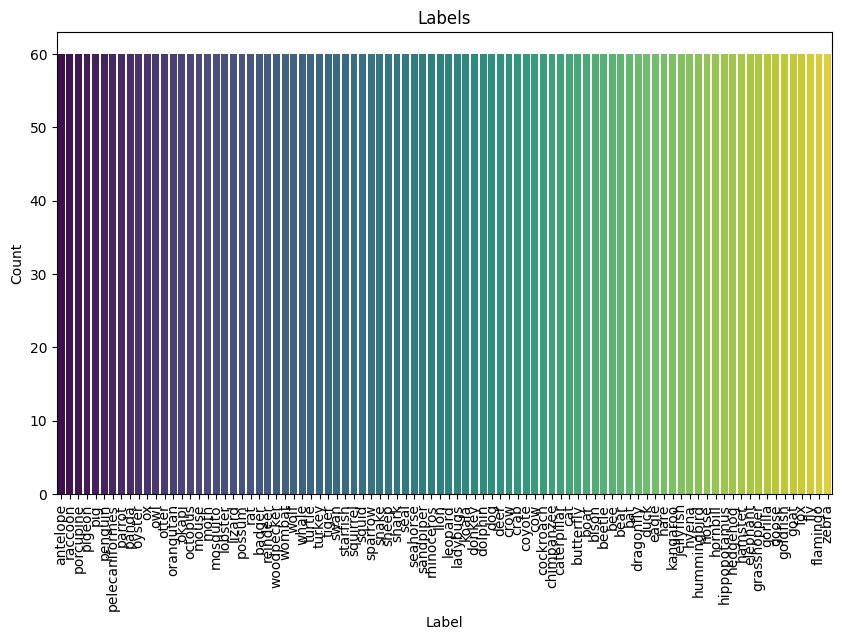

In [59]:
label_counts = df['label'].value_counts()

plt.figure(figsize=(10, 6))
sns.barplot(x=label_counts.index, y=label_counts.values, palette='viridis')  # Using seaborn for colored bars
plt.title('Labels')
plt.xlabel('Label')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

In [60]:
def display_image_for_each_label(data, num_labels_per_row=6):
    unique_labels = data['label'].unique()

    num_rows = (len(unique_labels) + num_labels_per_row - 1) // num_labels_per_row

    fig, axes = plt.subplots(nrows=num_rows, ncols=num_labels_per_row, figsize=(15, 3 * num_rows))
    fig.tight_layout(pad=3.0)

    axes = axes.flatten()

    for i, label in enumerate(unique_labels):
        label_data = data[data['label'] == label]
        image_path = label_data.iloc[0]['image_path']  # Taking the first image for each label

        try:
            image = Image.open(image_path)
            axes[i].imshow(image)
            axes[i].set_title(f"Label: {label}")
            axes[i].axis('off')
        except FileNotFoundError:
            axes[i].set_title(f"Image not found\n{image_path}")
            axes[i].axis('off')

    for j in range(i + 1, num_rows * num_labels_per_row):
        axes[j].axis('off')

    plt.show()

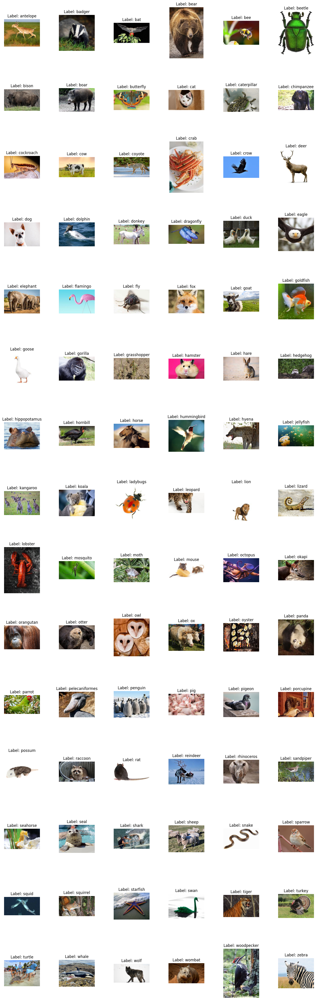

In [61]:
display_image_for_each_label(df)

In [62]:
weights = ResNet50_Weights.IMAGENET1K_V2
model = resnet50(weights=weights)
model.eval()

preprocess = weights.transforms()

In [63]:
imagenet_classes_response = requests.get("https://raw.githubusercontent.com/anishathalye/imagenet-simple-labels/master/imagenet-simple-labels.json")
imagenet_classes = json.loads(imagenet_classes_response.text)

test_dataset = datasets.ImageFolder(root='z3_data/test/', transform=preprocess)
dataset_classes = test_dataset.classes

In [64]:
test_dataloader = DataLoader(test_dataset, batch_size=32, shuffle=False)

actual_classes = []
predicted_classes = []
confidences = []

with torch.no_grad():
    for images, labels in test_dataloader:
        outputs = model(images)
        probabilities = F.softmax(outputs, dim=1)
        highest_probabilities, predicted_class_indices = torch.max(probabilities, dim=1)

        for i in range(images.size(0)):
            predicted_class_name = imagenet_classes[predicted_class_indices[i].item()]
            actual_class_name = dataset_classes[labels[i].item()]

            if actual_class_name in predicted_class_name:
                predicted_class_name = actual_class_name

            confidence = highest_probabilities[i].item() * 100

            actual_classes.append(actual_class_name)
            predicted_classes.append(predicted_class_name)
            confidences.append(confidence)

# Create a DataFrame
df = pd.DataFrame({
    "Actual Class": actual_classes,
    "Predicted Class": predicted_classes,
    "Confidence": confidences
})

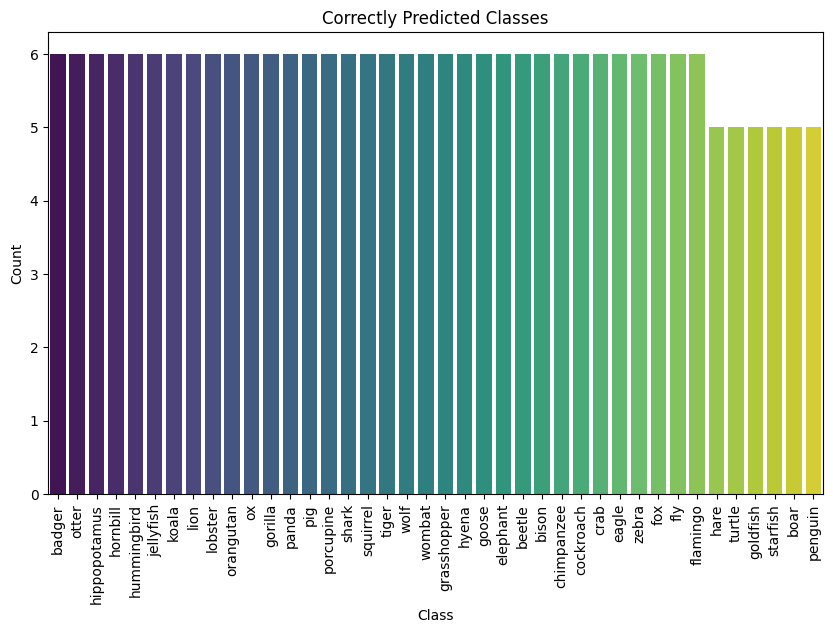

In [65]:
correctly_predicted = df[df['Actual Class'] == df['Predicted Class']]
class_counts = correctly_predicted['Actual Class'].value_counts().head(40)

# Plotting the histogram
plt.figure(figsize=(10, 6))
sns.barplot(x=class_counts.index, y=class_counts.values, palette='viridis')  # Using seaborn for colored bars
plt.title('Correctly Predicted Classes')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.show()

In [66]:
total_correct_predictions = (df['Actual Class'] == df['Predicted Class']).sum()
print(f"Total correct predictions: {total_correct_predictions}")

Total correct predictions: 283


In [67]:
df[df['Actual Class'] == df['Predicted Class']]['Actual Class'].unique()

array(['badger', 'bear', 'bee', 'beetle', 'bison', 'boar', 'butterfly',
       'cat', 'chimpanzee', 'cockroach', 'coyote', 'crab', 'dragonfly',
       'duck', 'eagle', 'elephant', 'flamingo', 'fly', 'fox', 'goldfish',
       'goose', 'gorilla', 'grasshopper', 'hamster', 'hare',
       'hippopotamus', 'hornbill', 'hummingbird', 'hyena', 'jellyfish',
       'koala', 'leopard', 'lion', 'lizard', 'lobster', 'mouse',
       'orangutan', 'otter', 'owl', 'ox', 'panda', 'parrot', 'penguin',
       'pig', 'porcupine', 'shark', 'snake', 'squirrel', 'starfish',
       'swan', 'tiger', 'turtle', 'whale', 'wolf', 'wombat', 'zebra'],
      dtype=object)

In [68]:
imagenet_class_set = set(imagenet_classes)
incorrect_predictions = df[df['Actual Class'] != df['Predicted Class']]
count_not_in_imagenet = incorrect_predictions['Actual Class'].apply(lambda x: x not in imagenet_class_set).sum()

print(f"Number of incorrectly predicted classes not present in ImageNet: {count_not_in_imagenet}")

Number of incorrectly predicted classes not present in ImageNet: 241


## Vytvorenie vlastneho konvolucneho sieta

In [96]:
class MyCNN(nn.Module):
    def __init__(self, num_classes):
        super(MyCNN, self).__init__()
        # Lists to store metrics
        self.training_losses = []
        self.validation_losses = []
        self.training_accuracies = []
        self.validation_accuracies = []

        self.conv1 = nn.Conv2d(in_channels=3, out_channels=64, kernel_size=3, padding=1)
        self.conv1_bn = nn.BatchNorm2d(64)

        self.conv2 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=3, padding=1)
        self.conv2_bn = nn.BatchNorm2d(128)

        self.conv3 = nn.Conv2d(in_channels=128, out_channels=256, kernel_size=3, padding=1)
        self.conv3_bn = nn.BatchNorm2d(256)

        self.conv4 = nn.Conv2d(in_channels=256, out_channels=512, kernel_size=3, padding=1)
        self.conv4_bn = nn.BatchNorm2d(512)

        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        self.fc1 = nn.Linear(512 * 14 * 14, 1024)
        self.fc1_bn = nn.BatchNorm1d(1024)
        self.fc2 = nn.Linear(1024, 512)
        self.fc2_bn = nn.BatchNorm1d(512)
        self.fc3 = nn.Linear(512, num_classes)

        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1_bn(self.conv1(x))))
        x = self.pool(F.relu(self.conv2_bn(self.conv2(x))))
        x = self.pool(F.relu(self.conv3_bn(self.conv3(x))))
        x = self.pool(F.relu(self.conv4_bn(self.conv4(x))))
        
        x = x.view(-1, 512 * 14 * 14)
        
        x = self.dropout(F.relu(self.fc1_bn(self.fc1(x))))
        x = self.dropout(F.relu(self.fc2_bn(self.fc2(x))))
        x = self.fc3(x)

        return x
    
    def train_model(self, train_loader, validation_loader, learning_rate, epochs, early_stopping_patience):
        criterion = nn.CrossEntropyLoss()
        optimizer = optim.Adam(self.parameters(), lr=learning_rate)

        best_val_loss = float('inf')
        epochs_no_improve = 0
        self.best_model_state = None

        for epoch in range(epochs):
            self.train()  # Set the model to training mode
            running_loss = 0.0
            correct_train = 0
            total_train = 0

            # Training loop
            for images, labels in train_loader:
                optimizer.zero_grad()
                outputs = self(images)
                loss = criterion(outputs, labels)
                loss.backward()
                optimizer.step()

                running_loss += loss.item()
                _, predicted = torch.max(outputs.data, 1)
                total_train += labels.size(0)
                correct_train += (predicted == labels).sum().item()

            # Calculate training loss and accuracy
            train_loss = running_loss / len(train_loader)
            train_accuracy = 100 * correct_train / total_train
            self.training_losses.append(train_loss)
            self.training_accuracies.append(train_accuracy)

            # Validation loop
            self.eval()
            validation_loss = 0.0
            correct_val = 0
            total_val = 0
            with torch.no_grad():
                for images, labels in validation_loader:
                    outputs = self(images)
                    loss = criterion(outputs, labels)
                    validation_loss += loss.item()
                    _, predicted = torch.max(outputs.data, 1)
                    total_val += labels.size(0)
                    correct_val += (predicted == labels).sum().item()

            # Calculate validation loss and accuracy
            val_loss = validation_loss / len(validation_loader)
            val_accuracy = 100 * correct_val / total_val
            self.validation_losses.append(val_loss)
            self.validation_accuracies.append(val_accuracy)

            print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.2f}%, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.2f}%")

            if val_loss < best_val_loss:
                best_val_loss = val_loss
                epochs_no_improve = 0
                self.best_model_state = self.state_dict().copy()
            else:
                epochs_no_improve += 1
                if epochs_no_improve == early_stopping_patience:
                    print(f"Early stopping triggered after {epoch + 1} epochs")
                    break

        print('Finished Training')


    def conf_matrix(self, test_loader):
        self.eval()  # Set the model to evaluation mode
        true_labels = []
        predictions = []

        with torch.no_grad():  # Disable gradient computation
            for images, _ in test_loader:
                outputs = self(images)
                _, predicted = torch.max(outputs, 1)
                true_labels.extend(labels.cpu().numpy())
                predictions.extend(predicted.cpu().numpy())

        return true_labels, predictions


    def calculate_accuracy(self, data_loader):
        model.eval()  # Set the model to evaluation mode
        correct_predictions = 0
        total_predictions = 0

        with torch.no_grad():  # Disable gradient computation
            for images, labels in data_loader:
                outputs = self(images)
                _, predicted = torch.max(outputs.data, 1)
                total_predictions += labels.size(0)
                correct_predictions += (predicted == labels).sum().item()

        accuracy = (correct_predictions / total_predictions) * 100
        return accuracy


    def save_model(self, file_path):
        torch.save(self.state_dict(), file_path)
        print(f"Model saved to {file_path}")


    def load_model(self, file_path):
        self.load_state_dict(torch.load(file_path, map_location=torch.device(device)))
        print(f"Model loaded from {file_path}")


    def plot_training_history(self):
        epochs = range(1, len(self.training_losses) + 1)

        # Plot Loss
        plt.figure(figsize=(12, 5))
        plt.subplot(1, 2, 1)
        plt.plot(epochs, self.training_losses, label='Training Loss')
        plt.plot(epochs, self.validation_losses, label='Validation Loss')
        plt.title('Training and Validation Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()

        # Plot Accuracy
        plt.subplot(1, 2, 2)
        plt.plot(epochs, self.training_accuracies, label='Training Accuracy')
        plt.plot(epochs, self.validation_accuracies, label='Validation Accuracy')
        plt.title('Training and Validation Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.legend()

        plt.tight_layout()
        plt.show()

    def confusion(self, test_loader):
        model.eval()  # Set the model to evaluation mode
        true_labels = []
        predictions = []

        with torch.no_grad():  # Disable gradient computation
            for images, labels in test_loader:
                outputs = model(images)
                _, predicted = torch.max(outputs, 1)
                true_labels.extend(labels.cpu().numpy())
                predictions.extend(predicted.cpu().numpy())

        confusion = confusion_matrix(true_labels, predictions)


        plt.figure(figsize=(50, 50))
        sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=dataset_classes, yticklabels=dataset_classes)
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()

In [97]:
def get_mean_std(loader):
    # Var[x] = E[X^2] - E^2[X]
    channels_sum, channels_squared_sum, num_batches = 0, 0, 0

    for data, _ in loader:
        # Mean over batch, height, and width, but not over the channels
        channels_sum += torch.mean(data, dim=[0, 2, 3])
        channels_squared_sum += torch.mean(data**2, dim=[0, 2, 3])
        num_batches += 1

    mean = channels_sum / num_batches
    std = (channels_squared_sum / num_batches - mean**2)**0.5

    print(f"Mean: {mean}")
    print(f"Std: {std}")

    return mean, std

In [71]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Resize((224, 224))
    ])
dataset = datasets.ImageFolder(root='z3_data/train', transform=transform)
data_loader = DataLoader(dataset, batch_size=32, shuffle=False)

mean, std = get_mean_std(data_loader)

Mean: tensor([0.5105, 0.5022, 0.4423])
Std: tensor([0.2856, 0.2705, 0.2909])


In [98]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

full_dataset = datasets.ImageFolder(root='z3_data/train/', transform=transform)

val_size = int(0.2 * len(full_dataset))
train_size = len(full_dataset) - val_size

train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])
test_dataset = datasets.ImageFolder(root='z3_data/test/', transform=transform)
dataset_classes = test_dataset.classes

In [112]:
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=False)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

In [113]:
num_classes = len(dataset_classes)
# model = MyCNN(num_classes)

In [167]:
print(model1)

MyCNN(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv1_bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv2_bn): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv3_bn): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (conv4): Conv2d(256, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (conv4_bn): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=100352, out_features=1024, bias=True)
  (fc1_bn): BatchNorm1d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=

In [120]:
# model.train_model(train_loader, val_loader, learning_rate, epochs, early_stopping_patience)
# lr = 0.001, batch_size = 32, dropout = 0.5
model1 = MyCNN(num_classes)
model1.load_model('models/model1.pth')

train_acc = model1.calculate_accuracy(train_loader)
val_acc = model1.calculate_accuracy(val_loader)
test_acc = model1.calculate_accuracy(test_dataloader)

print(f"Train Accuracy: {train_acc:.2f}%, Val Accuracy: {val_acc:.2f}%, Test Accuracy: {test_acc:.2f}%")

Model loaded from models/model1.pth
Train Accuracy: 84.83%, Val Accuracy: 85.19%, Test Accuracy: 15.00%


In [115]:
# model.train_model(train_loader, val_loader, learning_rate, epochs, early_stopping_patience)
# lr = 0.001, batch_size = 32, dropout = 0.3
model2 = MyCNN(num_classes)
model2.load_model('models/model2.pth')

train_acc = model2.calculate_accuracy(train_loader)
val_acc = model2.calculate_accuracy(val_loader)
test_acc = model2.calculate_accuracy(test_dataloader)

print(f"Train Accuracy: {train_acc:.2f}%, Val Accuracy: {val_acc:.2f}%, Test Accuracy: {test_acc:.2f}%")

Model loaded from models/model2.pth


Train Accuracy: 85.39%, Val Accuracy: 86.01%, Test Accuracy: 13.52%


In [116]:
# model.train_model(train_loader, val_loader, learning_rate, epochs, early_stopping_patience)
# lr = 0.001, batch_size = 32, dropout = 0.2
model3 = MyCNN(num_classes)
model3.load_model('models/model3.pth')

train_acc = model3.calculate_accuracy(train_loader)
val_acc = model3.calculate_accuracy(val_loader)
test_acc = model3.calculate_accuracy(test_dataloader)

print(f"Train Accuracy: {train_acc:.2f}%, Val Accuracy: {val_acc:.2f}%, Test Accuracy: {test_acc:.2f}%")

Model loaded from models/model3.pth
Train Accuracy: 84.52%, Val Accuracy: 86.11%, Test Accuracy: 14.81%


In [117]:
# model.train_model(train_loader, val_loader, learning_rate, epochs, early_stopping_patience)
# lr = 0.01, batch_size = 32, dropout = 0.5
model4 = MyCNN(num_classes)
model4.load_model('models/model4.pth')

train_acc = model4.calculate_accuracy(train_loader)
val_acc = model4.calculate_accuracy(val_loader)
test_acc = model4.calculate_accuracy(test_dataloader)

print(f"Train Accuracy: {train_acc:.2f}%, Val Accuracy: {val_acc:.2f}%, Test Accuracy: {test_acc:.2f}%")

Model loaded from models/model4.pth
Train Accuracy: 68.29%, Val Accuracy: 71.09%, Test Accuracy: 9.63%


In [118]:
# model.train_model(train_loader, val_loader, learning_rate, epochs, early_stopping_patience)
# lr = 0.01, batch_size = 32, dropout = 0.3
model5 = MyCNN(num_classes)
model5.load_model('models/model5.pth')

train_acc = model5.calculate_accuracy(train_loader)
val_acc = model5.calculate_accuracy(val_loader)
test_acc = model5.calculate_accuracy(test_dataloader)

print(f"Train Accuracy: {train_acc:.2f}%, Val Accuracy: {val_acc:.2f}%, Test Accuracy: {test_acc:.2f}%")

Model loaded from models/model5.pth
Train Accuracy: 46.84%, Val Accuracy: 49.79%, Test Accuracy: 7.59%


In [119]:
# model.train_model(train_loader, val_loader, learning_rate, epochs, early_stopping_patience)
# lr = 0.01, batch_size = 32, dropout = 0.2
model6 = MyCNN(num_classes)
model6.load_model('models/model3.pth')

train_acc = model6.calculate_accuracy(train_loader)
val_acc = model6.calculate_accuracy(val_loader)
test_acc = model6.calculate_accuracy(test_dataloader)

print(f"Train Accuracy: {train_acc:.2f}%, Val Accuracy: {val_acc:.2f}%, Test Accuracy: {test_acc:.2f}%")

Model loaded from models/model3.pth
Train Accuracy: 85.21%, Val Accuracy: 86.63%, Test Accuracy: 18.15%


In [121]:
df = pd.read_csv('models/model6_training_metrics.csv')

model6.training_losses = df['Training Loss']
model6.validation_losses = df['Validation Loss']
model6.training_accuracies = df['Training Accuracy']
model6.validation_accuracies = df['Validation Accuracy']

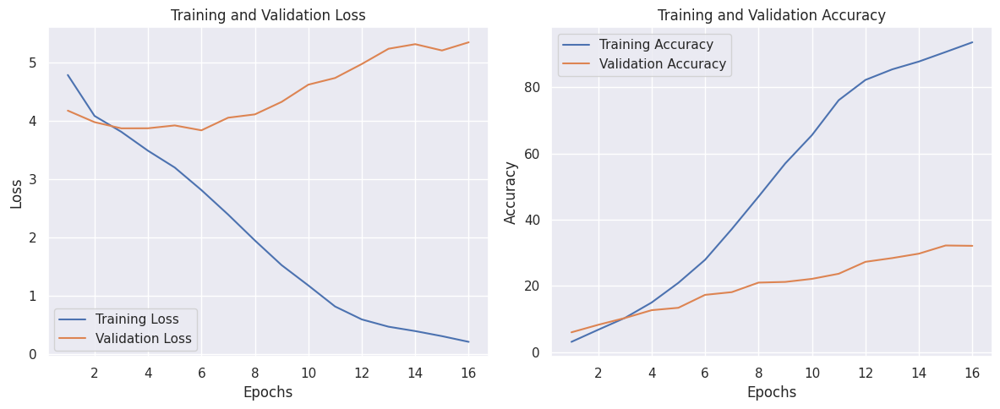

In [124]:
sns.set(font_scale=1.0)
model6.plot_training_history()

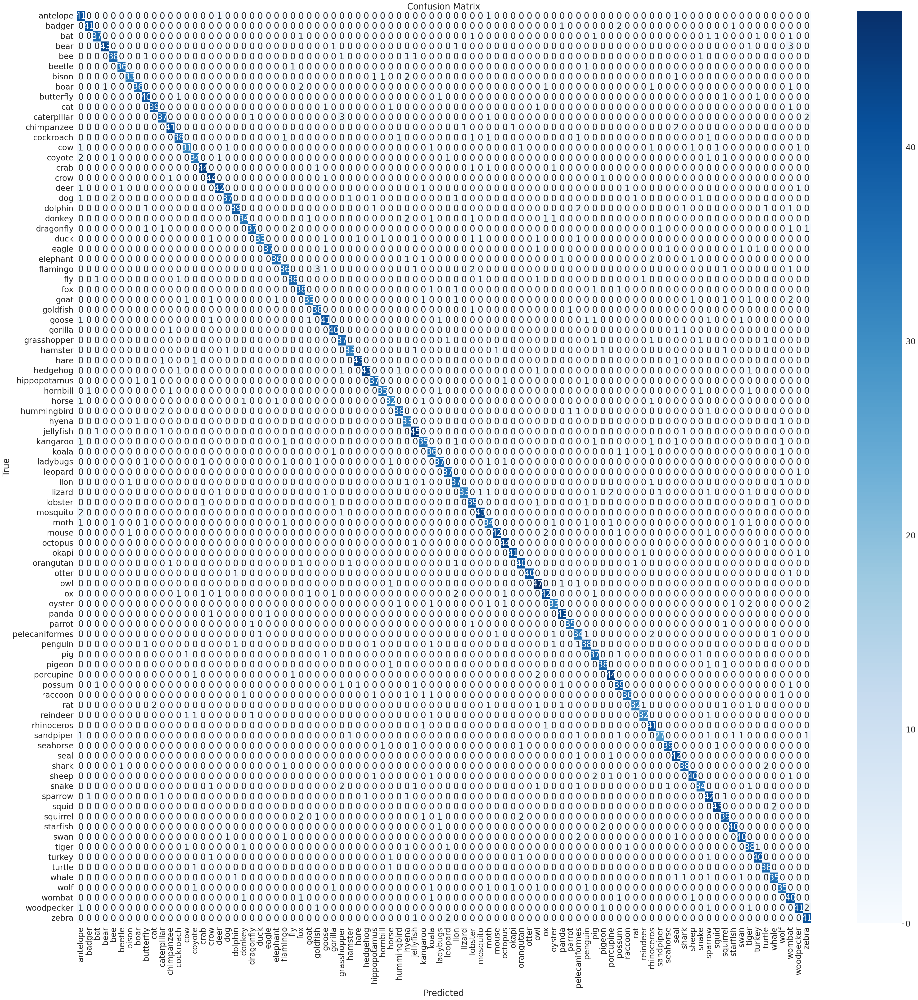

In [126]:
model6.confusion(train_loader)

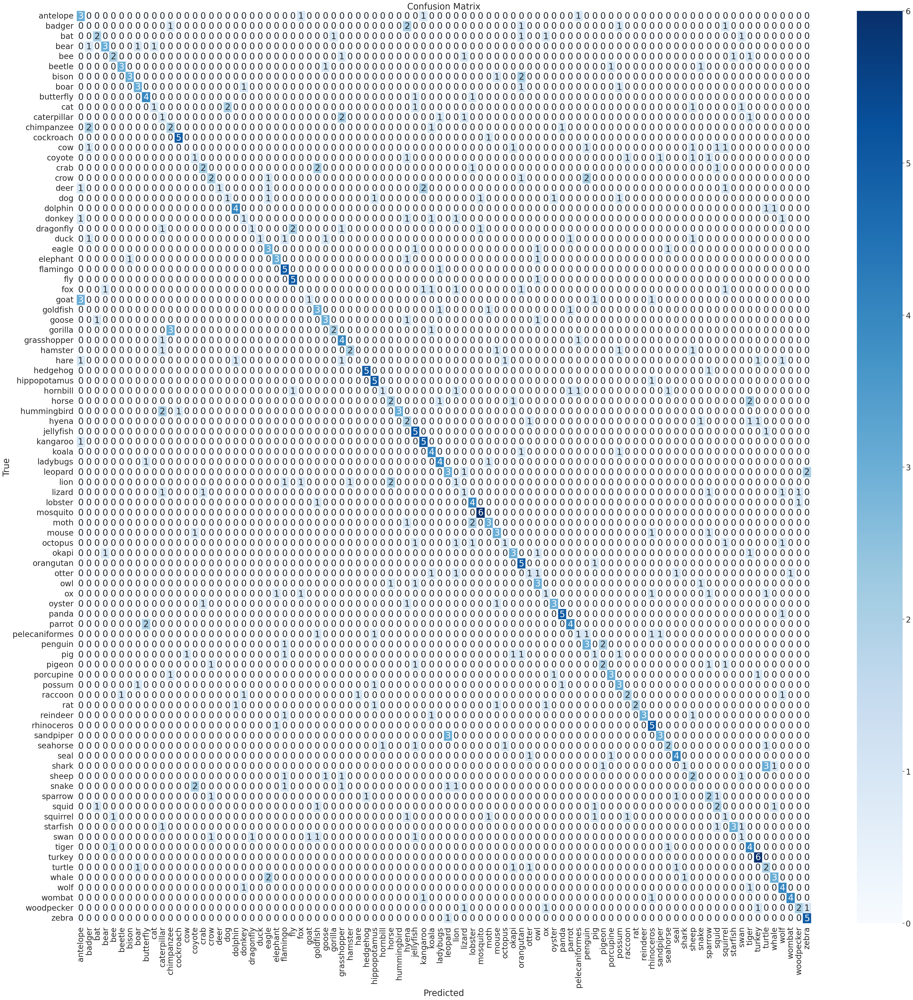

In [125]:
model6.confusion(test_loader)

## Generovanie priznakov pomocou sieti natrenovane na ImageNet

In [177]:
weights = ResNet50_Weights.IMAGENET1K_V2
resnet = resnet50(weights=weights)
model_features = nn.Sequential(*list(resnet.children())[:-1])

preprocess = weights.transforms()


In [178]:
class CustomDataset(datasets.ImageFolder):
    def __init__(self, root, transform=None):
        super().__init__(root, transform)

    def __getitem__(self, index):
        image_path, class_label = self.samples[index]

        image = self.loader(image_path)
        image = self.transform(image)
        
        return image, class_label, image_path

In [179]:
dataset_path = 'z3_data/train/'
data = {'Image Path': [], 'Class Label': [], 'Feature': []}

In [180]:
train_dataset = CustomDataset(root='z3_data/train/', transform=preprocess)
train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=False)

model_features.eval()

image_paths = []
class_labels = []
features_list = []

with torch.no_grad():
    for images, labels, image_paths_batch in train_dataloader:
        features = model_features(images)

        image_paths.extend(image_paths_batch)
        class_labels.extend(labels)
        features_list.append(features.view(features.size(0), -1).numpy())


features_array = np.concatenate(features_list)


In [181]:
assert len(image_paths) == len(class_labels) == features_array.shape[0]

idx_to_class = {v: k for k, v in train_dataset.class_to_idx.items()}
label_names = [idx_to_class[int(label)] for label in class_labels]

features_df = pd.DataFrame(features_array)

features_df.insert(0, 'label', label_names)
features_df.insert(0, 'image_path', image_paths)

feature_column_names = ['feature_' + str(i+1) for i in range(features_array.shape[1])]
features_df.columns = ['image_path', 'label'] + feature_column_names

In [132]:
features_df

,image_path,label,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,...,feature_2039,feature_2040,feature_2041,feature_2042,feature_2043,feature_2044,feature_2045,feature_2046,feature_2047,feature_2048
0,z3_data/train/antelope/03d7fc0888.jpg,antelope,0.0,0.029436,0.022404,0.0,0.000000,0.000000,0.004612,0.028869,...,0.000000,0.046245,0.000138,0.00586,0.000000,0.007993,0.0,0.000000,0.007514,0.019302
1,z3_data/train/antelope/0a37838e99.jpg,antelope,0.0,0.000000,0.000000,0.0,0.106369,0.000000,0.041993,0.000000,...,0.081651,0.000000,0.000000,0.00000,0.000000,0.009675,0.0,0.000000,0.000000,0.022446
2,z3_data/train/antelope/0b1a3af197.jpg,antelope,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
3,z3_data/train/antelope/0b688923b0.jpg,antelope,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.008169,...,0.080545,0.177092,0.000000,0.00000,0.004549,0.000000,0.0,0.000000,0.000000,0.031020
4,z3_data/train/antelope/0c16ef86c0.jpg,antelope,0.0,0.044906,0.000000,0.0,0.000000,0.042623,0.000000,0.000000,...,0.000000,0.020604,0.000000,0.00000,0.000690,0.015890,0.0,0.000000,0.000000,0.006815
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4855,z3_data/train/zebra/872a4e6a25.jpg,zebra,0.0,0.000000,0.000000,0.0,0.028271,0.068706,0.000000,0.000000,...,0.019101,0.000000,0.000000,0.00000,0.024716,0.000000,0.0,0.000000,0.000000,0.000000
4856,z3_data/train/zebra/8bc28d0165.jpg,zebra,0.0,0.000000,0.000000,0.0,0.000000,0.181362,0.036063,0.050058,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000
4857,z3_data/train/zebra/94cf6638fd.jpg,zebra,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.004161,0.0,0.002034,0.000000,0.000000
4858,z3_data/train/zebra/96e65ae7f7.jpg,zebra,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000


In [133]:
feature_reduction = features_df.drop(columns=['image_path', 'label'])

In [134]:
threshold = 0.6
corr_matrix = feature_reduction.corr().abs()

upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

features_reduced = feature_reduction.drop(to_drop, axis=1)

In [135]:
features_reduced.shape

(4860, 1925)

In [137]:
# features_reduced.drop(columns=['cluster', 'image_path'], inplace=True)

## Zhlukovanie priznakov pomocou K-means

In [138]:
inertia = []
for i in range(1, 60):
    kmeans = KMeans(n_clusters=i, random_state=RANDOM_SEED)
    kmeans.fit(features_reduced)
    inertia.append(kmeans.inertia_)

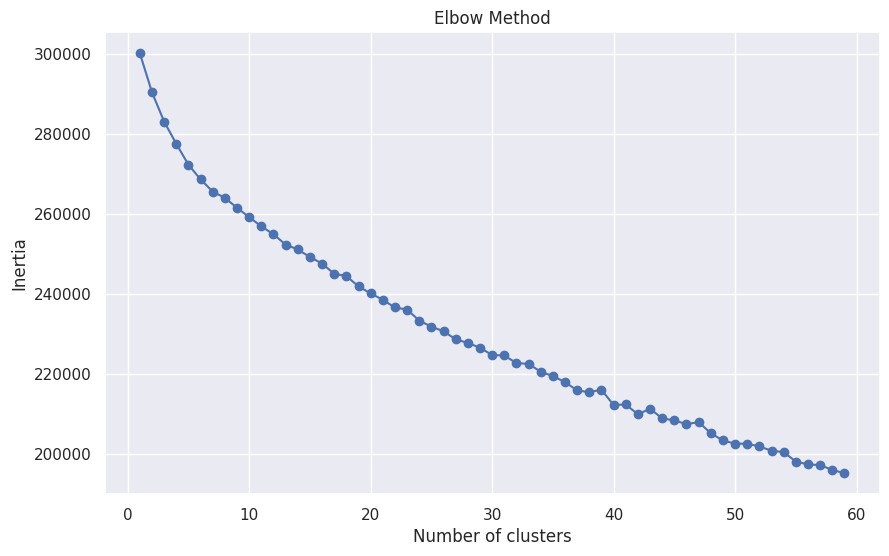

In [144]:
sns.set(font_scale=1.0)
plt.figure(figsize=(10, 6))
plt.plot(range(1, 60), inertia, marker='o')
plt.title('Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

In [145]:
kmeans = KMeans(n_clusters=40, random_state=RANDOM_SEED)
features_reduced['cluster'] = kmeans.fit_predict(features_reduced)

In [146]:
features_reduced.head(10)

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_2038,feature_2039,feature_2040,feature_2041,feature_2042,feature_2043,feature_2044,feature_2045,feature_2047,cluster
0,0.000000,0.029436,0.022404,0.000000,0.000000,0.000000,0.004612,0.028869,0.000000,0.026222,...,0.0,0.000000,0.046245,0.000138,0.005860,0.000000,0.007993,0.0,0.007514,19
1,0.000000,0.000000,0.000000,0.000000,0.106369,0.000000,0.041993,0.000000,0.000000,0.000000,...,0.0,0.081651,0.000000,0.000000,0.000000,0.000000,0.009675,0.0,0.000000,19
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.052017,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,31
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.008169,0.000000,0.000000,...,0.0,0.080545,0.177092,0.000000,0.000000,0.004549,0.000000,0.0,0.000000,19
4,0.000000,0.044906,0.000000,0.000000,0.000000,0.042623,0.000000,0.000000,0.000000,0.605595,...,0.0,0.000000,0.020604,0.000000,0.000000,0.000690,0.015890,0.0,0.000000,19
5,0.000000,0.000000,0.069611,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,31
6,0.000000,0.000000,0.000000,0.000000,0.000000,0.023567,0.119967,0.000000,0.000000,0.036505,...,0.0,0.012160,0.014411,0.000566,0.000000,0.000000,0.005077,0.0,0.053542,19
7,0.033328,0.040882,0.000000,0.055729,0.000000,0.042446,0.042377,0.003964,0.077569,0.215646,...,0.0,0.000000,0.004784,0.000000,0.036187,0.101802,0.000000,0.0,0.046066,0
8,0.000000,0.000000,0.000000,0.000000,0.000000,0.008780,0.000000,0.000000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,31
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.026960,0.033906,...,0.0,0.206297,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,31


In [147]:
features_reduced['image_path'] = features_df['image_path']

## Zobrazenie mnoziny obrazkov pre vsetky zhluky

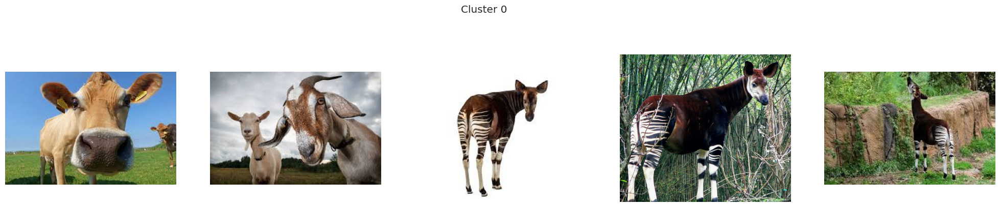

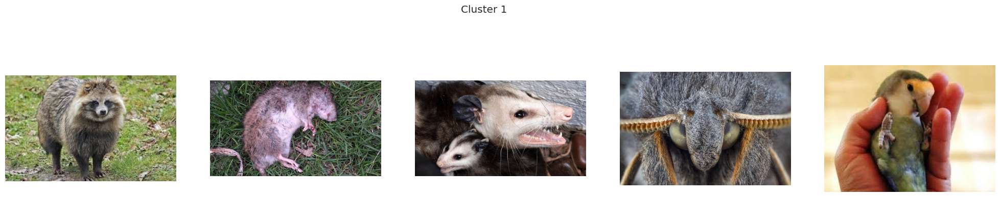

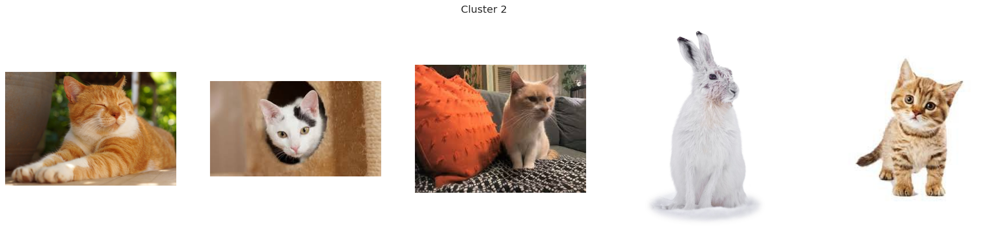

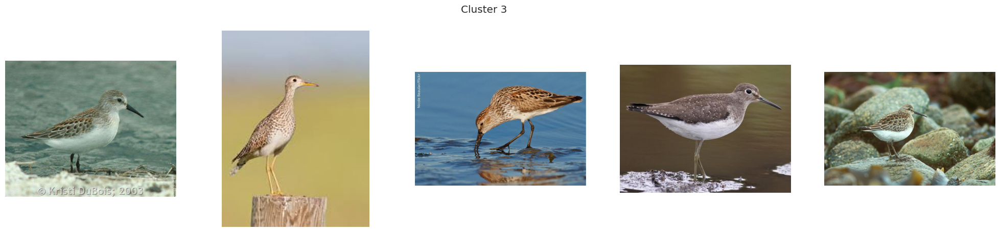

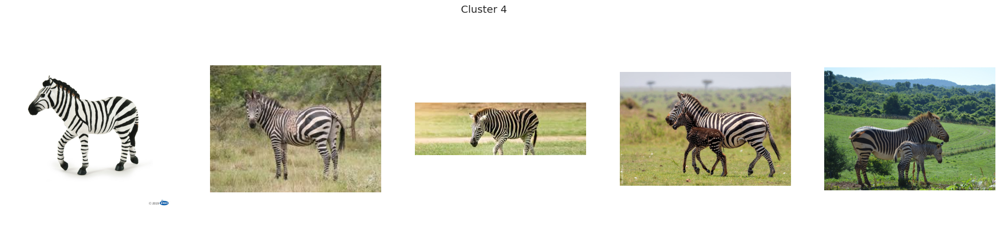

...

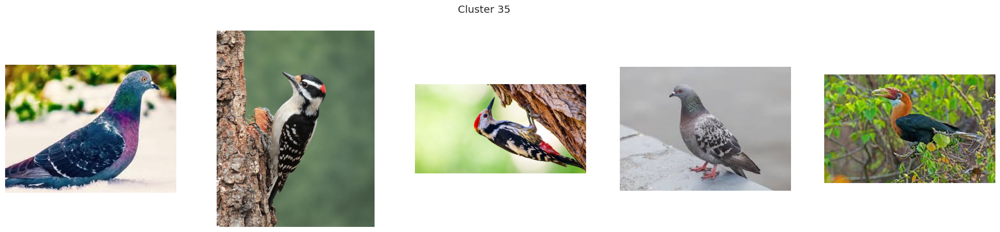

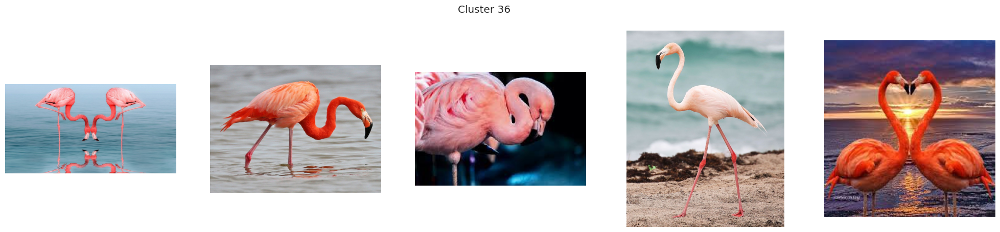

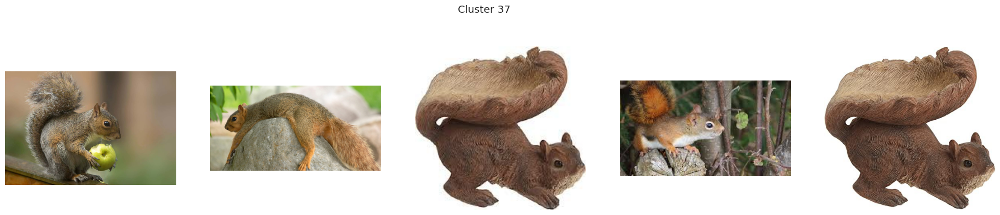

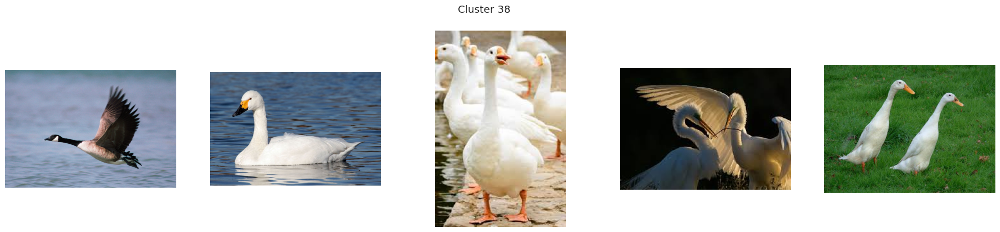

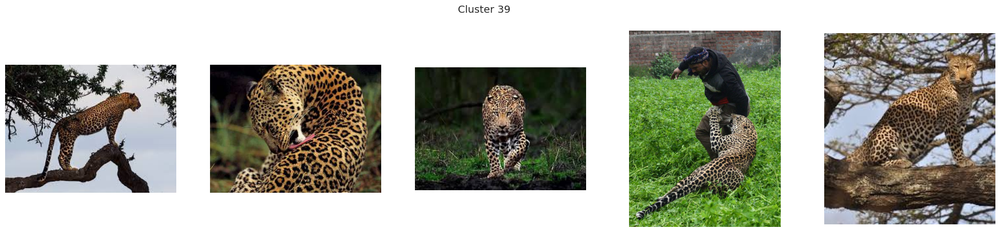

In [148]:
grouped = features_reduced.groupby('cluster')

selected_image_paths = {}

for cluster, data in grouped:
        selected_image_paths[cluster] = data['image_path'].sample(5).tolist()

# Now we will display 5 random images for each cluster
for cluster, image_paths in selected_image_paths.items():
    fig, axs = plt.subplots(1, 5, figsize=(25, 5))  # Adjust the figure size as needed
    fig.suptitle(f'Cluster {cluster}')
    for ax, image_path in zip(axs, image_paths):
        try:
            image = Image.open(image_path)
            ax.imshow(image)
        except Exception as e:
            print(f"Error loading image {image_path}: {e}")
        ax.axis('off')  # Hide the axis
    plt.show()

In [196]:
features_reduced.shape

(4860, 1927)

In [197]:
columns_to_exclude = ["cluster", "image_path"]
filtered_columns = features_reduced.drop(columns=columns_to_exclude).columns.tolist()

In [202]:
features_to_add = features_reduced[filtered_columns].shape[1] - (2 * 26 * 26)

In [204]:
mean_value = features_reduced[filtered_columns].mean().mean()

In [205]:
for i in range(features_to_add):
    features_reduced[f"added_feature_{i+1}"] = mean_value


In [207]:
features_reduced.shape[1]

2500

In [188]:
cluster_groups = features_df.groupby('label')

average_images = []
for cluster_id, cluster_data in cluster_groups:
    cluster_features = cluster_data[filtered_columns].values
    
    cluster_centroid = cluster_features.mean(axis=0)
    
    avg_image = cluster_centroid.reshape((3, 27, 27))  # Assuming image size is 32x32 and 3 channels
    average_images.append(avg_image)

ValueError: cannot reshape array of size 2048 into shape (3,27,27)

In [ ]:
# Step 4: Display average images
for i, avg_image in enumerate(average_images):
    plt.figure(figsize=(2, 2))
    plt.imshow(np.moveaxis(avg_image, 0, -1))  # Rearrange channels for displaying
    plt.title(f'Cluster {i+1}')
    plt.axis('off')
    plt.show()

In [151]:
X = features_df.drop(columns=['image_path', 'label'])
y = features_df['label']

In [154]:
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)

In [155]:
X_train, X_test, y_train, y_test = train_test_split(X, y_encoded, test_size=0.2, random_state=RANDOM_SEED)


In [162]:
# param_grid = {
#     'n_estimators': [50],
#     'max_features': ['auto', 'sqrt'],
#     'max_depth': [20, 30, 40],
#     'min_samples_split': [2, 5, 10],
#     'min_samples_leaf': [1, 2, 4],
#     # 'bootstrap': [True, False]
# }

param_grid = {
    'n_estimators': [100],
    'max_depth': [10, 30, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [163]:
rf = RandomForestClassifier()
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=3, n_jobs=-1, verbose=2)

In [164]:
grid_search.fit(X_train, y_train)

Fitting 3 folds for each of 27 candidates, totalling 81 fits


[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=  13.2s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=  13.7s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=  14.0s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=10, n_estimators=100; total time=  14.3s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=  14.4s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=2, n_estimators=100; total time=  14.8s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=  14.9s
[CV] END max_depth=10, min_samples_leaf=1, min_samples_split=5, n_estimators=100; total time=  16.0s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=2, n_estimators=100; total time=  16.9s
[CV] END max_depth=10, min_samples_leaf=2, min_samples_split=5, n_estimators=100; total t

GridSearchCV(cv=3, estimator=RandomForestClassifier(), n_jobs=-1,
             param_grid={'max_depth': [10, 30, 50],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100]},
             verbose=2)

In [165]:
best_params = grid_search.best_params_
best_rf_model = grid_search.best_estimator_

predictions = best_rf_model.predict(X_test)

In [193]:
predictions = best_rf_model.predict(X_train)
print("Train Accuracy:", accuracy_score(y_train, predictions))

Train Accuracy: 1.0


In [194]:
predictions = best_rf_model.predict(X_test)
print("Test Accuracy:", accuracy_score(y_test, predictions))

Test Accuracy: 0.8734567901234568


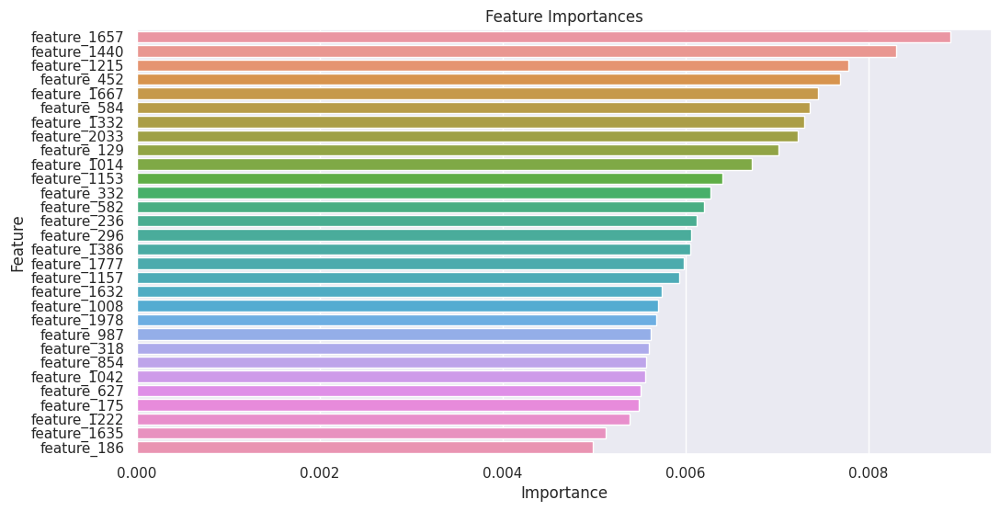

In [191]:
importances = best_rf_model.feature_importances_
feature_importances = pd.DataFrame({'feature': X_train.columns, 'importance': importances})

feature_importances = feature_importances.sort_values(by='importance', ascending=False).head(30)

plt.figure(figsize=(12, 6))
sns.set(font_scale=1.0)
sns.barplot(x='importance', y='feature', data=feature_importances)
plt.title('Feature Importances')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [195]:
print(best_params)

{'max_depth': 50, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
